Salomón Novoa Montenegro - 201212222 - s.novoa485

In [42]:
#Importamos las librerias

import pandas as pd
from pandas_profiling import ProfileReport

import matplotlib.pyplot as plt
import seaborn as sns

import re
from datetime import datetime

import numpy as np


from sklearn import linear_model

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split
from scipy import stats
from scipy.stats import chisquare, chi2_contingency, chi2
from scipy.stats import ttest_ind
import pingouin as pg


In [43]:
df = pd.read_csv('Data_Taller_2.csv',sep=';')

In [44]:
df

,instant,Date,Season,Holiday,Weather,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt
0,1,1/01/2020,Springer,No,Mist + Cloudy,"8,175849","9,090375","0,805833","10,749882",331,654,985
1,2,2/01/2020,Springer,No,Mist + Cloudy,"9,083466","8,625733","0,696087","-16,652113",131,670,801
2,3,3/01/2020,Springer,No,Few clouds,"1,229108","0,902035","0,437273","16,636703",120,1229,1349
3,4,4/01/2020,Springer,No,Few clouds,"1,4","1,969734","0,590435","10,739832",108,1454,1562
4,5,5/01/2020,Springer,No,Partly cloudy,"2,666979","2,77569","0,436957","12,5223",82,1518,1600
...,...,...,...,...,...,...,...,...,...,...,...,...
726,727,27/12/2021,Springer,No,Mist + Cloudy,"3,945849","2,652174","0,652917","23,458911",247,1867,2114
727,728,28/12/2021,Springer,No,Mist + Few clouds,"3,906651","3,987162","0,59","10,416557",644,2451,3095
728,729,29/12/2021,Springer,No,Mist,"3,906651","3,3928","0,752917","8,333661",159,1182,1341
729,730,30/12/2021,Springer,No,Few clouds,"4,024151","2,8899","0,483333","23,500518",364,1432,1796


In [45]:
df['Date'] = pd.to_datetime(df['Date'], dayfirst=True, errors='coerce')

In [46]:
df['Feel_Temp'] = df['Feel_Temp'].str.replace(',','.').astype(float)
df['Temp'] = df['Temp'].str.replace(',','.').astype(float)
df['Hum'] = df['Hum'].str.replace(',','.').astype(float)
df['Wind'] = df['Wind'].str.replace(',','.').astype(float)

In [47]:
profile = ProfileReport(df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Limpieza y preparación de datos (25 pts)

Búsqueda y corrección de valores atípicos, valores faltantes y duplicados. Debido a que la
base de datos no es muy grande, deberá abstenerse de eliminar registros. Así mismo,
busque la oportunidad de generar nuevas variables con base en la información
suministrada.

In [48]:
# LLenamos el valor nulo teniendo en cuenta el ordne de la toma de los datos
df[df['Date'].isna()]

,instant,Date,Season,Holiday,Weather,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt
424,425,NaT,Springer,No,Mist,8.184356,8.37809,0.804783,12.000839,65,1769,1834


In [49]:
df[423:]

,instant,Date,Season,Holiday,Weather,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt
423,424,2021-02-28,Springer,No,Few clouds,8.880849,8.615675,0.395833,12.958939,229,4134,4363
424,425,NaT,Springer,No,Mist,8.184356,8.378090,0.804783,12.000839,65,1769,1834
425,426,2021-03-01,Springer,No,Clear,14.834151,14.342437,0.615417,15.208129,325,4665,4990
426,427,2021-03-02,Springer,No,Mist + Broken clouds,8.606651,8.912574,0.657083,9.708568,246,2948,3194
427,428,2021-03-03,Springer,No,Mist + Few clouds,11.465849,11.434124,0.621250,10.792293,956,3110,4066
...,...,...,...,...,...,...,...,...,...,...,...,...
726,727,2021-12-27,Springer,No,Mist + Cloudy,3.945849,2.652174,0.652917,23.458911,247,1867,2114
727,728,2021-12-28,Springer,No,Mist + Few clouds,3.906651,3.987162,0.590000,10.416557,644,2451,3095
728,729,2021-12-29,Springer,No,Mist,3.906651,3.392800,0.752917,8.333661,159,1182,1341
729,730,2021-12-30,Springer,No,Few clouds,4.024151,2.889900,0.483333,23.500518,364,1432,1796


In [50]:
#llenamos los nulos
df.Temp = df.Temp.fillna((df.Temp.shift() + df.Temp.shift(-1))/2)
df.Date = df.Date.fillna(df.Date.shift())


{'whiskers': [<matplotlib.lines.Line2D at 0x7fb0da759e80>,
 'caps': [<matplotlib.lines.Line2D at 0x7fb0da733730>,
 'boxes': [<matplotlib.lines.Line2D at 0x7fb0da759a60>],
 'medians': [<matplotlib.lines.Line2D at 0x7fb0da733fa0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7fb0da736670>],
 'means': []}

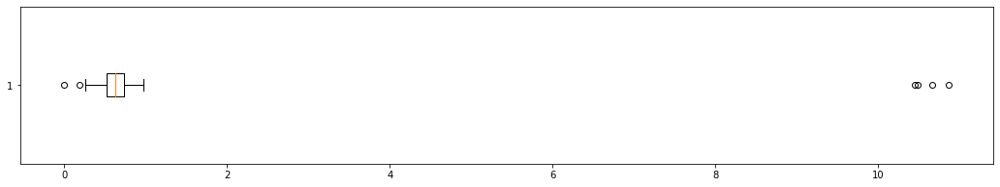

In [51]:
plt.figure(figsize = (18, 3))
plt.boxplot(df['Hum'], vert = False)

In [52]:
df.describe()

,instant,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt
count,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000
mean,366.000000,15.287848,14.294637,0.682614,12.668792,848.176471,3656.172367,4504.348837
std,211.165812,8.602380,7.659175,0.750679,5.417463,686.622488,1560.256377,1937.211452
min,1.000000,-5.220871,-4.283729,0.000000,-16.652113,2.000000,20.000000,22.000000
25%,183.500000,7.842925,7.878597,0.522291,9.000746,315.500000,2497.000000,3152.000000
50%,366.000000,15.421651,14.876451,0.629167,12.124789,713.000000,3662.000000,4548.000000
75%,548.500000,22.804575,20.604294,0.732708,15.624802,1096.000000,4776.500000,5956.000000
max,731.000000,32.498349,31.522112,10.867083,34.000021,3410.000000,6946.000000,8714.000000


In [53]:
df['Hum'] = np.where(df['Hum']>1.5, (df.Hum.shift() + df.Hum.shift(-1))/2,df['Hum'])
df['Wind'] = np.where(df['Wind']<0, (df.Hum.shift() + df.Hum.shift(-1))/2,df['Wind'])

In [54]:
df.describe()

,instant,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt
count,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000
mean,366.000000,15.287848,14.294637,0.627859,12.718220,848.176471,3656.172367,4504.348837
std,211.165812,8.602380,7.659175,0.142369,5.242916,686.622488,1560.256377,1937.211452
min,1.000000,-5.220871,-4.283729,0.000000,0.615417,2.000000,20.000000,22.000000
25%,183.500000,7.842925,7.878597,0.521041,9.000746,315.500000,2497.000000,3152.000000
50%,366.000000,15.421651,14.876451,0.625833,12.124789,713.000000,3662.000000,4548.000000
75%,548.500000,22.804575,20.604294,0.730209,15.624802,1096.000000,4776.500000,5956.000000
max,731.000000,32.498349,31.522112,0.972500,34.000021,3410.000000,6946.000000,8714.000000


In [55]:
# Se crea el mes y el día para entender mejor el comprtamiento
df['Month'] =  pd.DatetimeIndex(df['Date']).month
df['Day'] =  pd.DatetimeIndex(df['Date']).day
df['Year'] =  pd.DatetimeIndex(df['Date']).year
df['WDay'] =  pd.DatetimeIndex(df['Date']).weekday


Respuesta:
1.	Se importaron las librerías
2.	Se cambió el formato de las fechas
3.	Se cambiarons las comas por puntos para las variables float
4.	Se llenaron los datos nulos para temperatura, date, hum y wind 
    a.	Fue necesario llenar un missing value en date porque había un error en la fecha 
5.	Se crearon las vairbles mes y día


Análisis de datos (15 pts)

Analice las variables que conforman la base de datos. Realice análisis univariados y bivariados según considere. No olvide utilizar técnicas de análisis visual.

In [56]:
profile = ProfileReport(df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:xlabel='Season'>

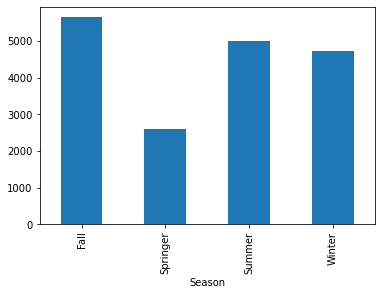

In [57]:

df.groupby('Season')['cnt'].mean().plot.bar()

<AxesSubplot:xlabel='Year,Month'>

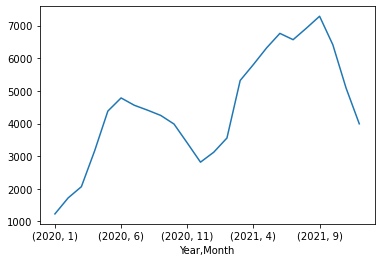

In [58]:
df.groupby(['Year','Month'])['cnt'].mean().plot.line()

WDay
0    4603.759615
1    4633.836538
2    4600.990476
3    4269.180952
4    4278.590476
5    4477.271845
6    4668.476190
Name: cnt, dtype: float64

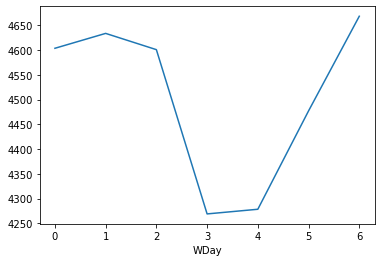

In [59]:
df.groupby(['WDay'])['cnt'].mean().plot.line()
df.groupby(['WDay'])['cnt'].mean()

In [60]:
df.groupby('Year')['cnt'].mean()

Year
2020    3405.761644
2021    5599.934426
Name: cnt, dtype: float64

In [61]:

df['Casual'].sum()/df['cnt'].sum()

0.18830168382645257

Punto 2

•	La cantidad de días en las temporadas se encuentra alrededor del 25%, lo cual tiene sentido
•	En promedio la temperatura del 2020 y 2021 es de 15.42grados, de igual forma la sensación térmica es 14.96, 0.46 grados menos
•	Se evidencia una relación positiva entre la temperatura y la cantidad total de usuario, cuando la temperatura aumenta, la cantidad de usuarios también lo hace
•	En promedio, Las personas utilizan más las patinetas en otoño y se reduce a menos de la mitad en spring
•	La cantidad de usuarios ha aumentado en el tiempo 66% del año 2020 al 2021
•	El día no parece ser impactar el número de usuarios
•	El porcentaje de usuarios casuales es igual el 18% del total
•	Existe una alta correlación entre la temperatura y la feel temp, lo cual tiene mucho sentido

Desarrollo de modelos de regresión (30 pts)

Implemente al menos 3 modelos basados en el algoritmo de regresión lineal: uno simple, uno polinomial y uno con algún tipo de regularización.

In [62]:

# Two-way Chisquare test for the relationship between AcceptedCmp1 and AcceptedCmp4
contingencyTable = pd.crosstab(index=[df.Season], columns=df.Weather, values=df.cnt, aggfunc='sum')/ df.cnt.sum()#(df['Season'],df['Weather'])
#print(contingencyTable)
stat, p, dof, expected = chi2_contingency(contingencyTable)
stat, p, dof, expected

# interpret test-statistic
prob = 0.95
critical = chi2.ppf(prob, dof)
if abs(stat) >= critical:
    print('Dependent (reject H0)')
else:
    print('Independent (fail to reject H0)')
contingencyTable

Independent (fail to reject H0)


Weather,Partly cloudy,Partly cloudy,Clear,Few clouds,Light Rain + Scattered clouds,Mist,Mist + Broken clouds,Mist + Cloudy,Mist + Few clouds,Rain + Thunderstorm,Snow
Season,,,,,,,,,,,
Fall,0.070569,0.059639,0.060545,0.052042,0.001429,0.014589,0.014592,0.031989,0.014961,0.001914,NaN
Springer,0.025348,0.019101,0.016351,0.033966,0.000189,0.009145,0.012798,0.009731,0.015574,0.000288,0.000659
Summer,0.044633,0.044771,0.052804,0.048210,0.000241,0.018202,0.031773,0.022477,0.015044,0.000312,0.000512
Winter,0.041381,0.028716,0.043216,0.044458,0.002094,0.019765,0.027099,0.022862,0.022147,0.002145,0.001719


In [63]:
df['Weather'].unique()

array(['Mist + Cloudy', 'Few clouds', ' Partly    cloudy', 'Clear',
       'Mist', 'Mist + Broken clouds', ' Partly cloudy',
       'Mist + Few clouds', 'Rain + Thunderstorm',
       'Light Rain + Scattered clouds', 'Snow'], dtype=object)

In [64]:
df_= df.drop(columns=['instant','Temp','Registered','Casual','Date'])
df_.WDay=df_.WDay.astype("category")
df_.Month=df_.Month.astype("category")
df_

,Season,Holiday,Weather,Feel_Temp,Hum,Wind,cnt,Month,Day,Year,WDay
0,Springer,No,Mist + Cloudy,9.090375,0.805833,10.749882,985,1,1,2020,2
1,Springer,No,Mist + Cloudy,8.625733,0.696087,0.621553,801,1,2,2020,3
2,Springer,No,Few clouds,0.902035,0.437273,16.636703,1349,1,3,2020,4
3,Springer,No,Few clouds,1.969734,0.590435,10.739832,1562,1,4,2020,5
4,Springer,No,Partly cloudy,2.775690,0.436957,12.522300,1600,1,5,2020,6
...,...,...,...,...,...,...,...,...,...,...,...
726,Springer,No,Mist + Cloudy,2.652174,0.652917,23.458911,2114,12,27,2021,0
727,Springer,No,Mist + Few clouds,3.987162,0.590000,10.416557,3095,12,28,2021,1
728,Springer,No,Mist,3.392800,0.752917,8.333661,1341,12,29,2021,2
729,Springer,No,Few clouds,2.889900,0.483333,23.500518,1796,12,30,2021,3


In [65]:
# hacemos las dummies
df_ = pd.get_dummies(df_,drop_first=True)

In [66]:
df_

,Feel_Temp,Hum,Wind,cnt,Day,Year,Season_Springer,Season_Summer,Season_Winter,Holiday_Yes,...,Month_9,Month_10,Month_11,Month_12,WDay_1,WDay_2,WDay_3,WDay_4,WDay_5,WDay_6
0,9.090375,0.805833,10.749882,985,1,2020,1,0,0,0,...,0,0,0,0,0,1,0,0,0,0
1,8.625733,0.696087,0.621553,801,2,2020,1,0,0,0,...,0,0,0,0,0,0,1,0,0,0
2,0.902035,0.437273,16.636703,1349,3,2020,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,1.969734,0.590435,10.739832,1562,4,2020,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0
4,2.775690,0.436957,12.522300,1600,5,2020,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,2.652174,0.652917,23.458911,2114,27,2021,1,0,0,0,...,0,0,0,1,0,0,0,0,0,0
727,3.987162,0.590000,10.416557,3095,28,2021,1,0,0,0,...,0,0,0,1,1,0,0,0,0,0
728,3.392800,0.752917,8.333661,1341,29,2021,1,0,0,0,...,0,0,0,1,0,1,0,0,0,0
729,2.889900,0.483333,23.500518,1796,30,2021,1,0,0,0,...,0,0,0,1,0,0,1,0,0,0


In [67]:
data = df_
features = df_

In [68]:
features= features.drop(columns=['cnt']).columns
# Dividimos la info
X = data[features]
Y = data['cnt']

In [69]:
# Divimos en test y train 
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.3, random_state = 1)

In [70]:
# Escalamos min max
scaler = MinMaxScaler()

In [71]:
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
pd.DataFrame(X_train_scaled)

,0,1,2,3,4,5,6,7,8,9,...,26,27,28,29,30,31,32,33,34,35
0,0.651852,0.894432,0.321000,0.400000,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,0.650070,0.743040,0.284891,0.500000,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.625676,0.660673,0.370698,0.600000,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.638792,0.859629,0.230676,0.033333,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.455049,0.701856,0.128327,0.266667,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
506,0.469850,0.632250,0.319487,0.200000,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
507,0.401078,0.813805,0.221639,0.500000,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
508,0.348765,0.337991,0.309232,0.433333,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
509,0.760630,0.488399,0.590484,0.766667,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [72]:
# Hacemos la primera regresión lineal, 

lr = linear_model.SGDRegressor( penalty='none',n_iter_no_change= 1000)
lr.fit(X_train_scaled, Y_train)
preds_test = lr.predict(X_test_scaled)
preds_train = lr.predict(X_train_scaled)
data['cnt'].mean(),mean_squared_error(Y_train, preds_train, squared=False),mean_squared_error(Y_test, preds_test, squared=False), mean_squared_error(Y_test, preds_test, squared=False)/data['cnt'].mean()


/Users/salomonnovoamontenegro/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1503: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


(4504.3488372093025, 726.0147601467544, 845.3633596508565, 0.18767715161568319)

In [73]:
polinomio = [1,2,3,4]
penalidad = ['elasticnet','none','l1','l2']
#alpha= [100,10,1,0.1,0.001,0.0001]

In [74]:
# Se crean los ciclos con los hiperparámetros y resultados

results = pd.DataFrame()
m=0

for i in polinomio:
    m += 1
    poly = PolynomialFeatures(i)
    X_train_poly = poly.fit_transform(X_train_scaled)
    X_test_poly = poly.fit_transform(X_test_scaled)
    for j in penalidad:
        lr = linear_model.SGDRegressor(penalty=j)
        lr.fit(X_train_poly, Y_train)
        preds_test = lr.predict(X_test_poly)
        preds_train = lr.predict(X_train_poly)
        error_percet_test=mean_squared_error(Y_test, preds_test, squared=False)/data['cnt'].mean()
        error_percet_train=mean_squared_error(Y_train, preds_train,  squared=False)/data['cnt'].mean()

        df_2 = [[i, j,error_percet_train,error_percet_test,mean_squared_error(Y_test, preds_test, squared=False)]]
        df2 = pd.DataFrame(df_2,columns=['poly', 'pen','error_percet_train','error_percet_test','rmse_test'])

            #results = pd.concat(results,df_2)
#            results.append(df_2)

        results=pd.concat([results, df2], ignore_index=True)
    print(m)

1
2
3
4


/Users/salomonnovoamontenegro/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1503: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


In [78]:
results

,poly,pen,error_percet_train,error_percet_test,rmse_test
0,1,elasticnet,0.163133,0.192136,865.447460
1,1,none,0.162656,0.191204,861.250194
2,1,l1,0.162906,0.191655,863.282670
3,1,l2,0.163008,0.191894,864.355383
4,2,elasticnet,0.099785,0.175171,789.031485
5,2,none,0.097906,0.175333,789.760354
6,2,l1,0.095008,0.175634,791.115559
7,2,l2,0.094707,0.175616,791.034944
8,3,elasticnet,0.052331,0.178405,803.599987
9,3,none,0.059549,0.177773,800.749468


In [79]:
results[results.error_percet_test ==results.error_percet_test.min()]

,poly,pen,error_percet_train,error_percet_test,rmse_test
4,2,elasticnet,0.099785,0.175171,789.031485


Punto 2

•	Se revisó si season y weather son independientes para saber si era necesario quitar una de las dos

•	Se quitaron las variables 'instant','Temp','Registered','Casual','Date'

•	Se dummificaron las variables categóricas

•	Se reescalaron las variables con minmaxscaler()

•	Se desarrolló la regresión lineal y se obtuvo un rmse train y test de 726.00 y 845.68, con un error % de 18.77%

•	De igual forma se realizaron 23 modelos más, con regresiones polinomiales de de grado (1,2,3,4,5,6) tipos de regularización, l1, l2 y Elasticnet

•	Se escogió el mejor modelo que corresponde a regresión con polinomio 4, con regularización l1 y se obtuvo un error percentual igual a 16.4% y un rmse 741.435, lo cual es un buen resultado para predecir la cantidad de usuarios


In [92]:
polinomio = [1]
penalidad = ['l1']
#alpha= [100,10,1,0.1,0.001,0.0001]


results = pd.DataFrame()
m=0

for i in polinomio:
    m += 1
    poly = PolynomialFeatures(i)
    X_train_poly = poly.fit_transform(X_train_scaled)
    X_test_poly = poly.fit_transform(X_test_scaled)
    for j in penalidad:
        lr = linear_model.SGDRegressor(penalty=j)
        lr.fit(X_train_poly, Y_train)
        preds_test = lr.predict(X_test_poly)
        preds_train = lr.predict(X_train_poly)
        error_percet_test=mean_squared_error(Y_test, preds_test, squared=False)/data['cnt'].mean()
        error_percet_train=mean_squared_error(Y_train, preds_train,  squared=False)/data['cnt'].mean()

        df_2 = [[i, j,error_percet_train,error_percet_test,mean_squared_error(Y_test, preds_test, squared=False)]]
        df2 = pd.DataFrame(df_2,columns=['poly', 'pen','error_percet_train','error_percet_test','rmse_test'])

            #results = pd.concat(results,df_2)
#            results.append(df_2)

        results=pd.concat([results, df2], ignore_index=True)
    print(m)

1


In [93]:
poly.fit_transform(X_test)
columns = poly.get_feature_names(X_test.columns)
coef_pol = dict(zip(columns, lr.coef_))

pd.Series(coef_pol).to_frame('Coeff')

/Users/salomonnovoamontenegro/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,Coeff
1,1371.945159
Feel_Temp,2609.557037
Hum,-975.159719
Wind,-772.977782
Day,-239.820299
Year,2112.309671
Season_Springer,-1092.769716
Season_Summer,73.442941
Season_Winter,545.006336
Holiday_Yes,-191.241412


In [ ]:
Punto 3

Interpretación (10 pts)
El día de la presentación de resultados, una persona de la alcaldía le hace las siguientes
preguntas:
● ¿Cuáles son las 3 variables más importantes para la predicción de la cantidad de
usuarios?
● Describa cual es el escenario ideal para el incremento de usuarios.
● ¿Qué pasos adicionales deberían tener en cuenta para una próxima
iteración/mejora del modelo?

In [100]:
coeficientes = pd.Series(coef_pol).to_frame('Coeff')
coeficientes['Coeff_abs'] = abs(coeficientes.Coeff)
coeficientes.sort_values('Coeff_abs',ascending=False)

,Coeff,Coeff_abs
Feel_Temp,2609.557037,2609.557037
Year,2112.309671,2112.309671
1,1371.945159,1371.945159
Weather_Rain + Thunderstorm,-1314.991354,1314.991354
Month_9,1102.354850,1102.354850
Season_Springer,-1092.769716,1092.769716
Weather_Light Rain + Scattered clouds,-1053.984871,1053.984871
Hum,-975.159719,975.159719
Wind,-772.977782,772.977782
Month_5,665.591050,665.591050


In [ ]:
Punto 3
•	Las variables más importantes para el modelo son:
1.	El mes
2.	La sensación térmica
3.	El clima

La cantidad de usuarios aumenta a medida que la sensación térmica aumenta también, igualmente es importante que no esté lloviendo, que sea primavera, que la humedad sea baja, que no sea jueves, entre otros.

Calcular la importancia de las variables incluyendo las variables polinominealizadas



In [95]:
coeficientes.to_csv('out.csv')